In [60]:
import pickle
file = open('data.pickle','rb')
test_img_dict = pickle.load(file)

In [61]:
import torch
import torch.nn.functional as F

0


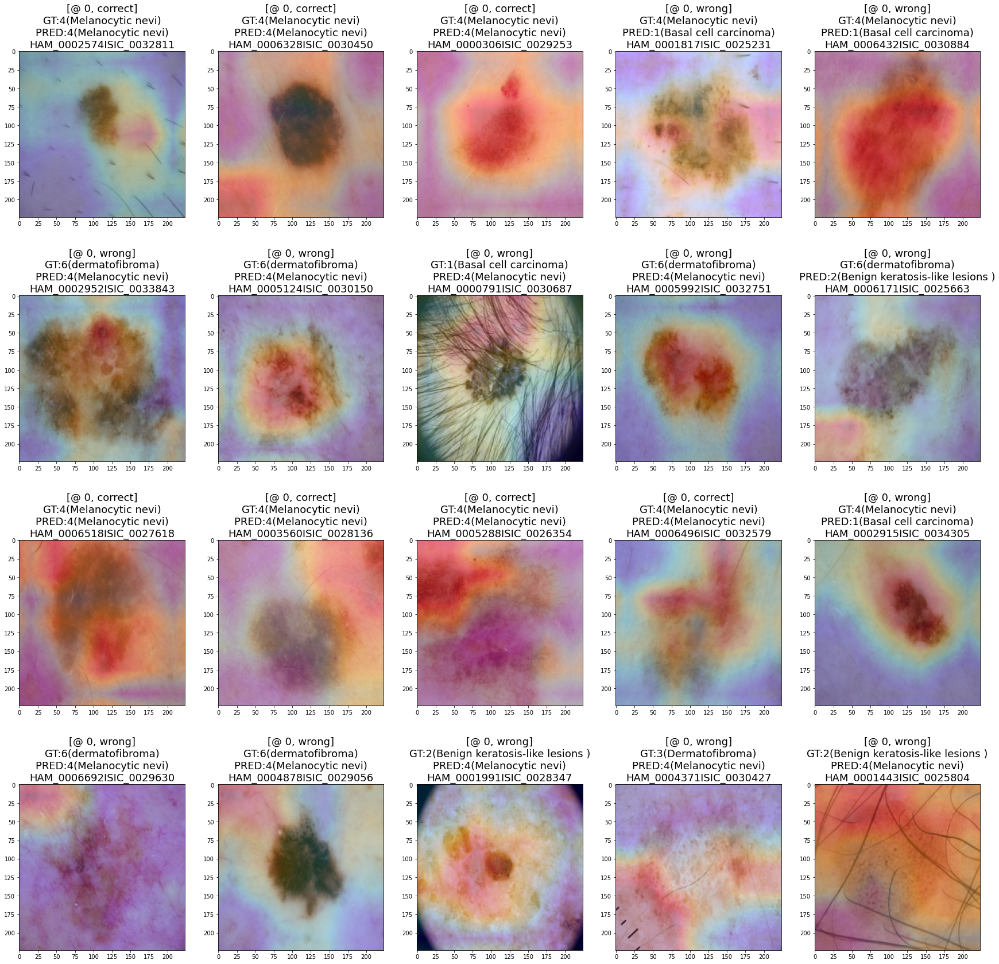

In [62]:
import matplotlib.pyplot as plt
categories = {2: 'Benign keratosis-like lesions ', 4: 'Melanocytic nevi', 3: 'Dermatofibroma', 6: 'dermatofibroma', 5: 'Vascular lesions', 1: 'Basal cell carcinoma', 0: 'Actinic keratoses'}
len(test_img_dict) # 20
n_samples = 5

to_list = [k for k in test_img_dict.keys()]
overlay_idx = [to_list[:n_samples],
               to_list[n_samples:2*n_samples], 
               to_list[2*n_samples:3*n_samples],
               to_list[3*n_samples:4*n_samples],
               to_list[4*n_samples:]]

# types=['correct','wrong']
# overlay_idx = [
# correct_tuple,
# wrong_tuple
# ]
num_epoch = 1
for epoch in range(num_epoch):
    print(epoch)
    fig, m_axs = plt.subplots(4, n_samples, figsize = (30,30))
    for row_idx,(row_axes, sample_file_list) in enumerate(zip(m_axs, overlay_idx)):
        for col_idx,(col_ax, sample_name) in enumerate(zip(row_axes,sample_file_list)):
            col_ax.imshow(test_img_dict[sample_name][epoch][0])
            col_ax.imshow(test_img_dict[sample_name][epoch][1],cmap=plt.cm.jet,alpha=0.2) #bottle_resized = resize(heatmap_j[batch_idx], (224,224))
            gt_val, pred_val = int(test_img_dict[sample_name][epoch][2]), int(test_img_dict[sample_name][epoch][3])
            if gt_val == pred_val:
                ans = 'correct'
            else:
                ans = 'wrong'
       
            col_ax.set_title(f"[@ {epoch}, {ans}]"+'\n'+
            f"GT:{gt_val}({categories[gt_val]})"+'\n'
             +f"PRED:{pred_val}({categories[pred_val]})" +'\n'
            +f"{sample_name}", fontsize=18)
    plt.show()

<ipython-input-63-3cba2779394e>:34: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  gt_prob = F.softmax(sample_epoch_val[4])[gt_val].item()
<ipython-input-63-3cba2779394e>:35: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  pred_prob = torch.max(F.softmax(sample_epoch_val[4])).item() # sample_epoch_val[4]


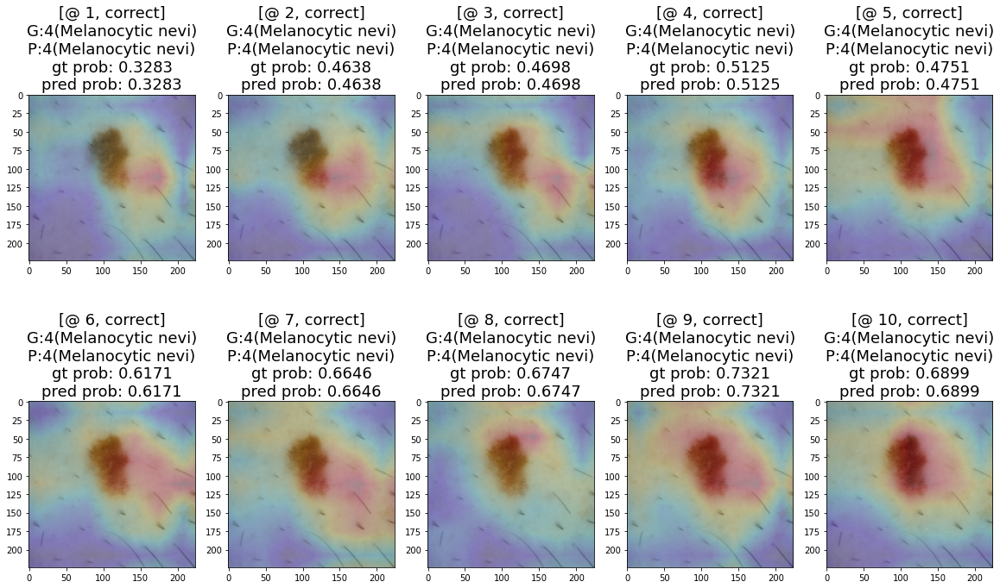

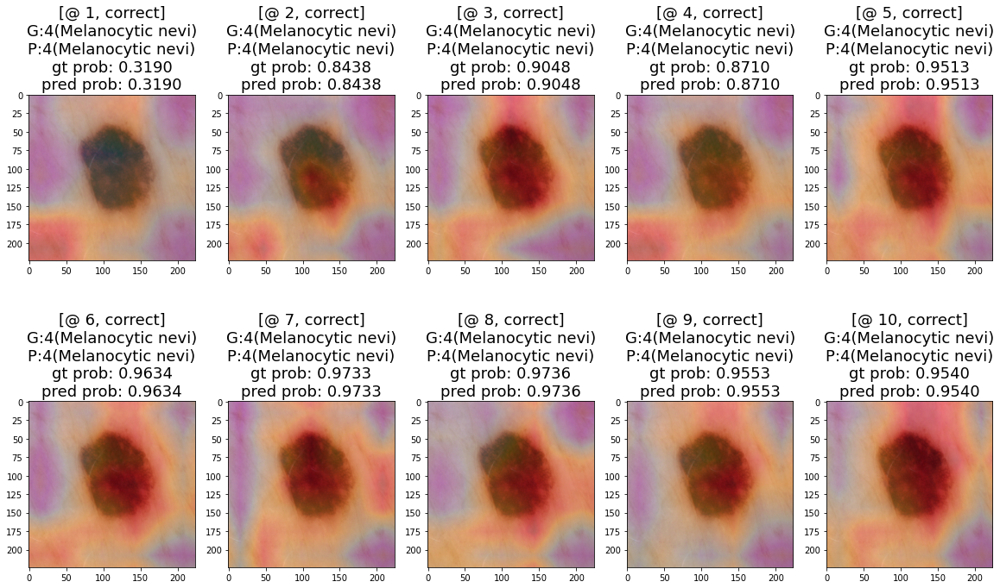

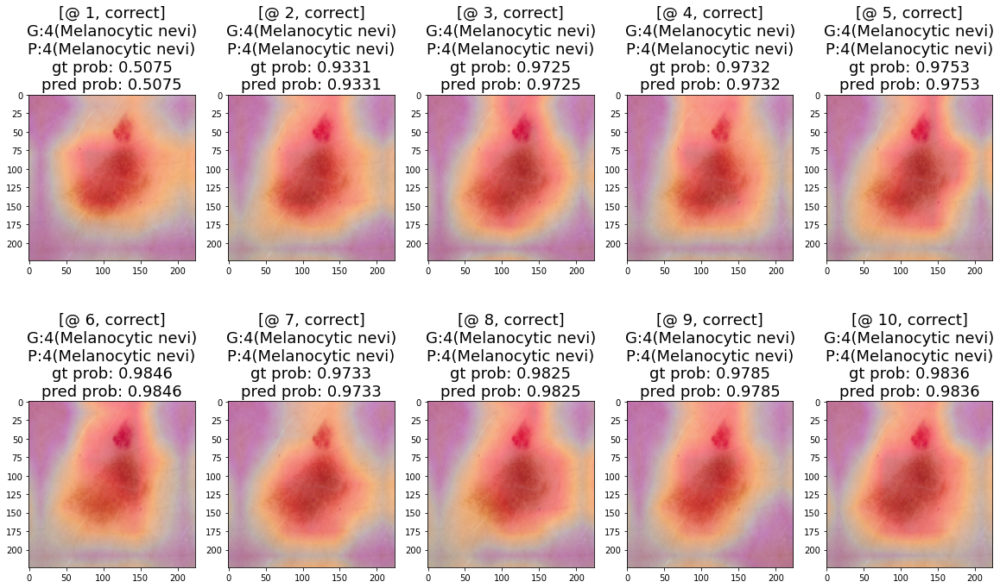

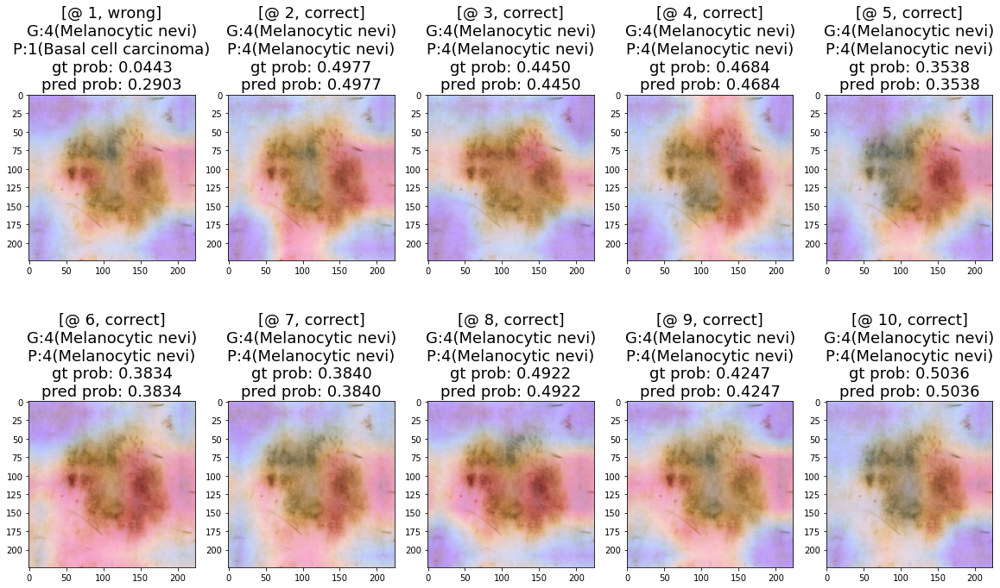

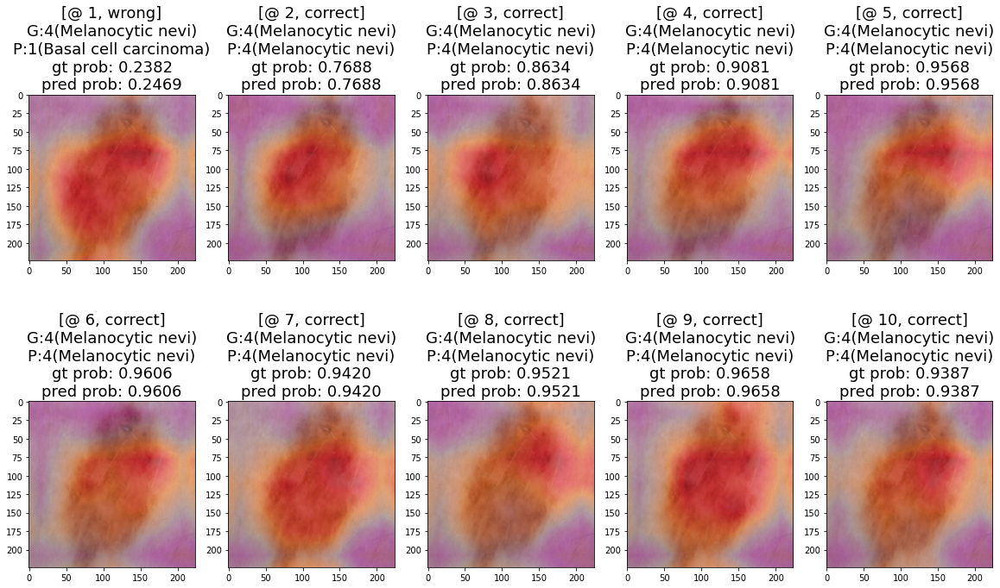

...

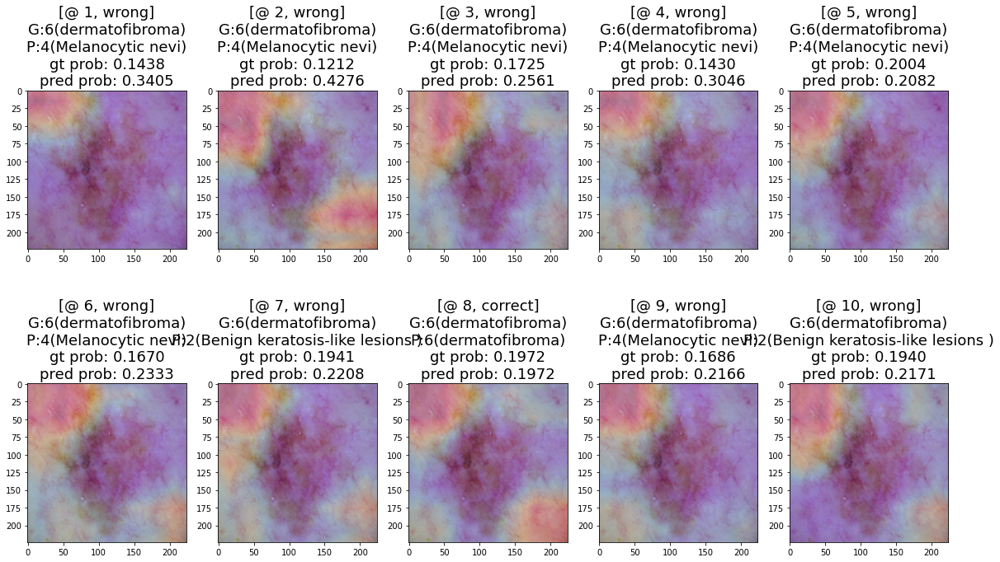

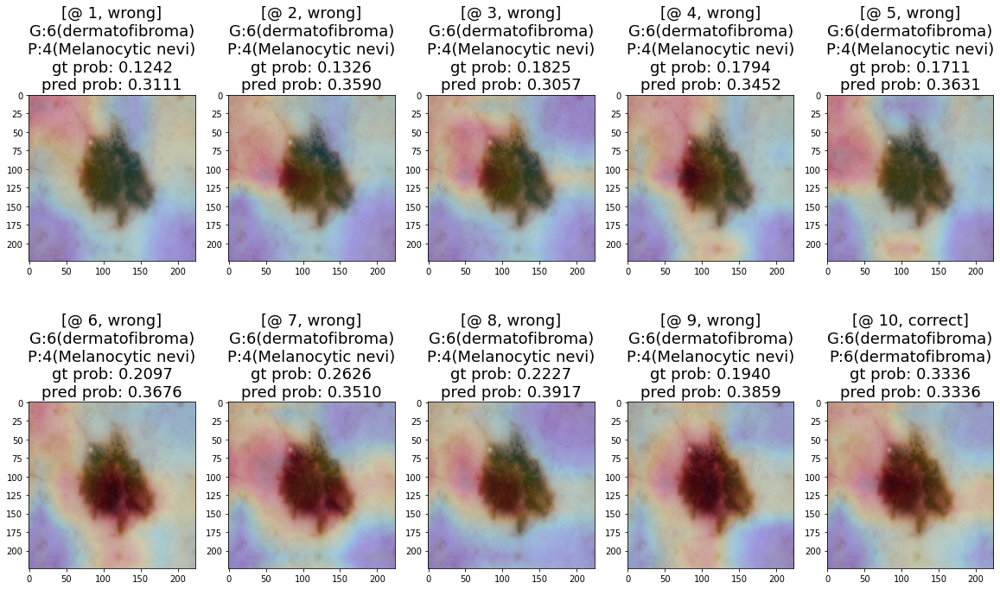

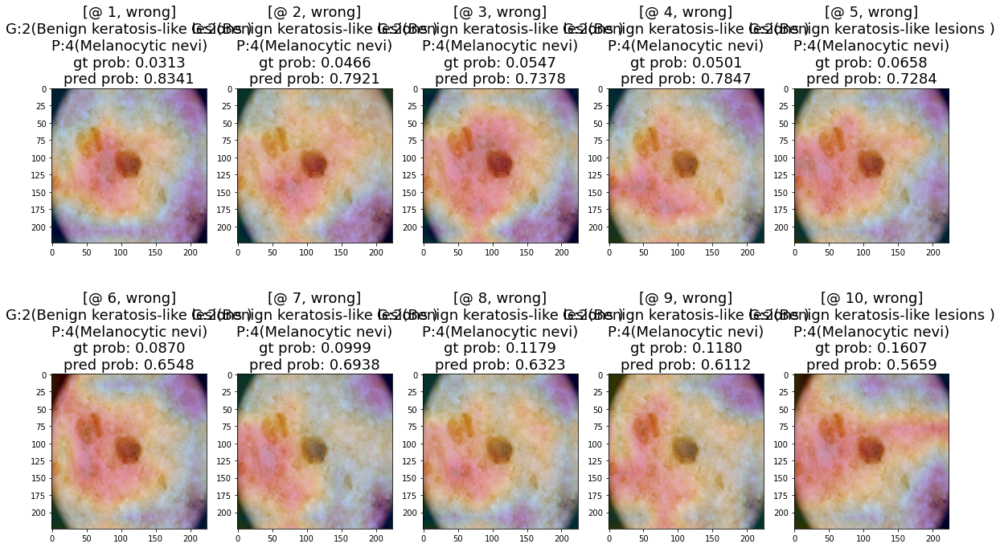

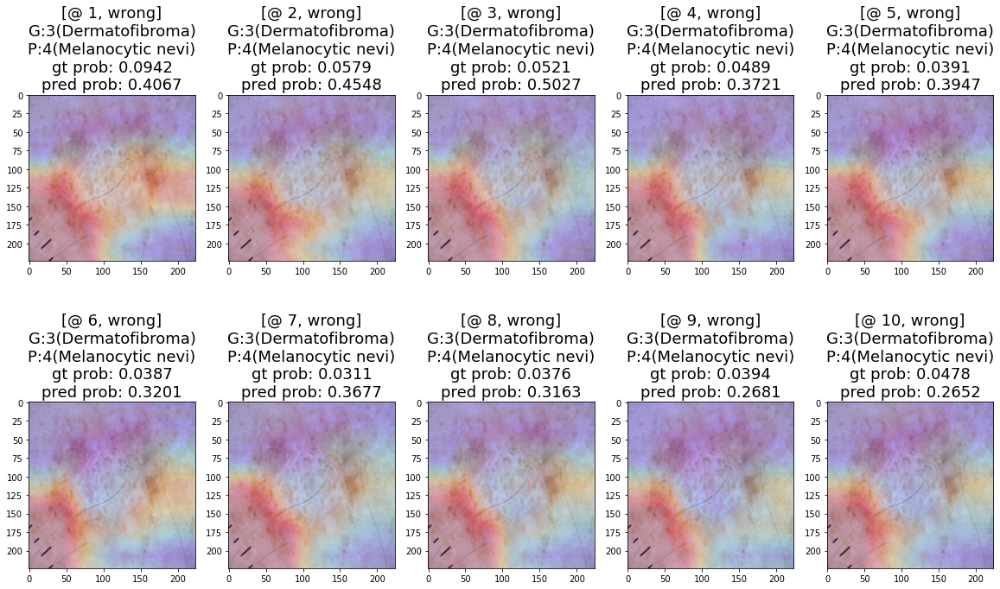

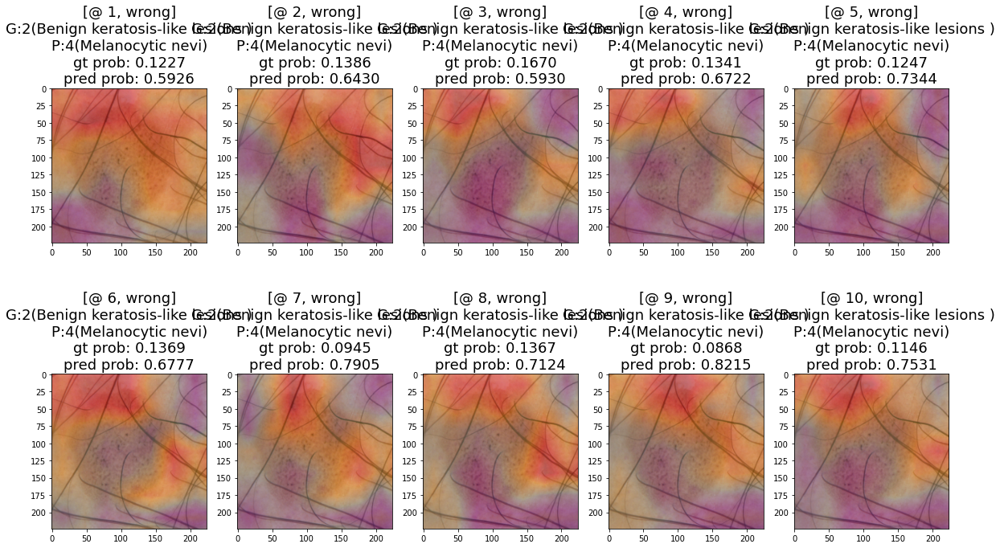

In [63]:
len(test_img_dict) # 20

# img_idx = 0

# name = to_list[img_idx]
# # 각 epoch 별 값
# vals = test_img_dict[to_list[img_idx]]

# overlay_idx = [
# vals[:5],
# vals[5:10]
# ]

n_samples = 5
to_list = [k for k in test_img_dict.keys()]

for img_idx in range(len(to_list)):
    epoch_cnt = 1
    name = to_list[img_idx]
    # 각 epoch 별 값
    vals = test_img_dict[to_list[img_idx]]

    overlay_idx = [
    vals[:5],
    vals[5:10]
    ]
    fig, m_axs = plt.subplots(2, n_samples, figsize = (20,12))
    for row_idx,(row_axes, sample_epoch_list) in enumerate(zip(m_axs, overlay_idx)):
        # :5번째, 5:10 번째 epoch에 대한 값들
        for col_idx,(col_ax, sample_epoch_val) in enumerate(zip(row_axes,sample_epoch_list)):
            col_ax.imshow(sample_epoch_val[0])
            col_ax.imshow(sample_epoch_val[1],cmap=plt.cm.jet,alpha=0.2) #bottle_resized = resize(heatmap_j[batch_idx], (224,224))
            gt_val, pred_val = int(sample_epoch_val[2]), int(sample_epoch_val[3])
            gt_prob = F.softmax(sample_epoch_val[4])[gt_val].item()
            pred_prob = torch.max(F.softmax(sample_epoch_val[4])).item() # sample_epoch_val[4]
            if gt_val == pred_val:
                ans = 'correct'
            else:
                ans = 'wrong'
            col_ax.set_title(f"[@ {epoch_cnt}, {ans}]"+'\n'
             + f"G:{gt_val}({categories[gt_val]})"+'\n'
             +f"P:{pred_val}({categories[pred_val]})" + '\n' 
             +f"gt prob: {gt_prob:.4f}"+'\n'
             +f"pred prob: {pred_prob:.4f}" ,
                             fontsize=18)
            epoch_cnt += 1
#             col_ax.set_title(f"[@ {epoch}, {ans}]"+'\n'+
#             f"GT:{gt_val}({categories[gt_val]})"+'\n'
#              +f"PRED:{pred_val}({categories[pred_val]})" +'\n'
#             +f"{sample_name}", fontsize=18)
    plt.show()

In [45]:
import torch
import torch.nn.functional as F
torch.max(F.softmax(sample_epoch_val[4])).item()

<ipython-input-45-53b80aafaa1d>:3: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  torch.max(F.softmax(sample_epoch_val[4])).item()


0.6899493336677551

In [50]:
F.softmax(sample_epoch_val[4])

<ipython-input-50-c5193598a4df>:1: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  F.softmax(sample_epoch_val[4])


tensor([0.0118, 0.0422, 0.1146, 0.0089, 0.7531, 0.0077, 0.0616],
       device='cuda:0', grad_fn=<SoftmaxBackward0>)

In [64]:
file = open('data_scratch.pickle','rb')
test_img_dict = pickle.load(file)

<ipython-input-66-842e54a333d1>:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  gt_prob = F.softmax(sample_epoch_val[4])[gt_val].item()
<ipython-input-66-842e54a333d1>:22: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  pred_prob = torch.max(F.softmax(sample_epoch_val[4])).item() # sample_epoch_val[4]


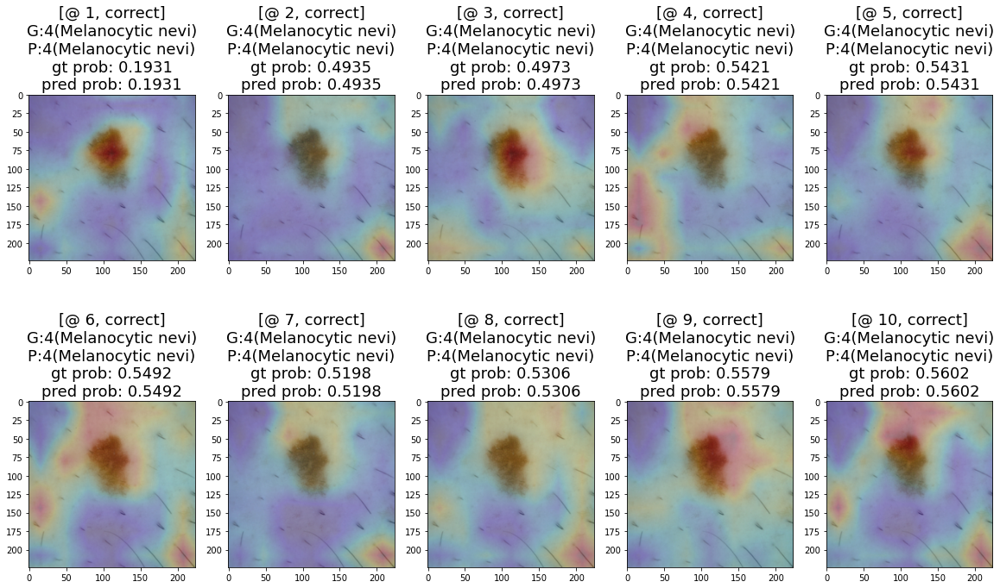

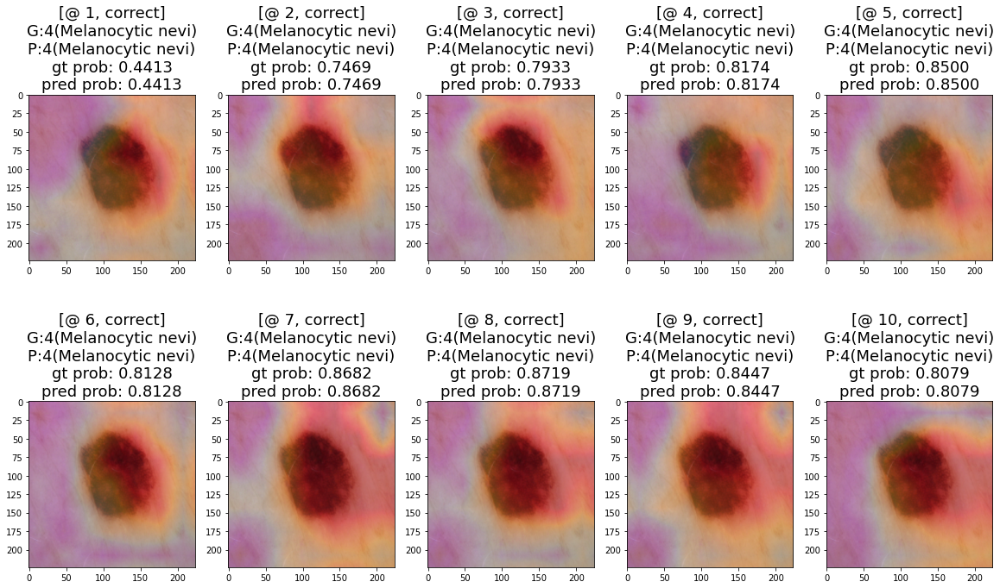

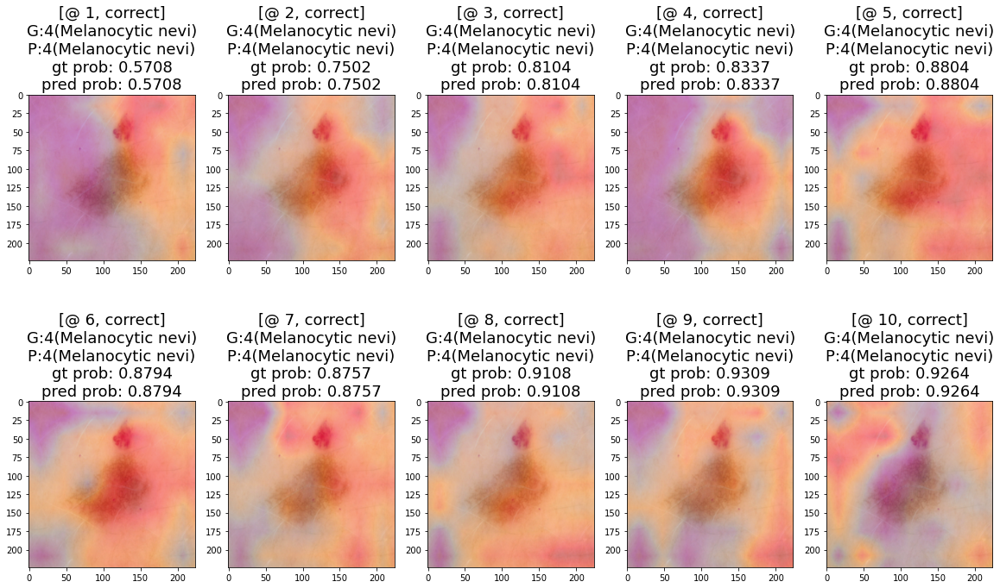

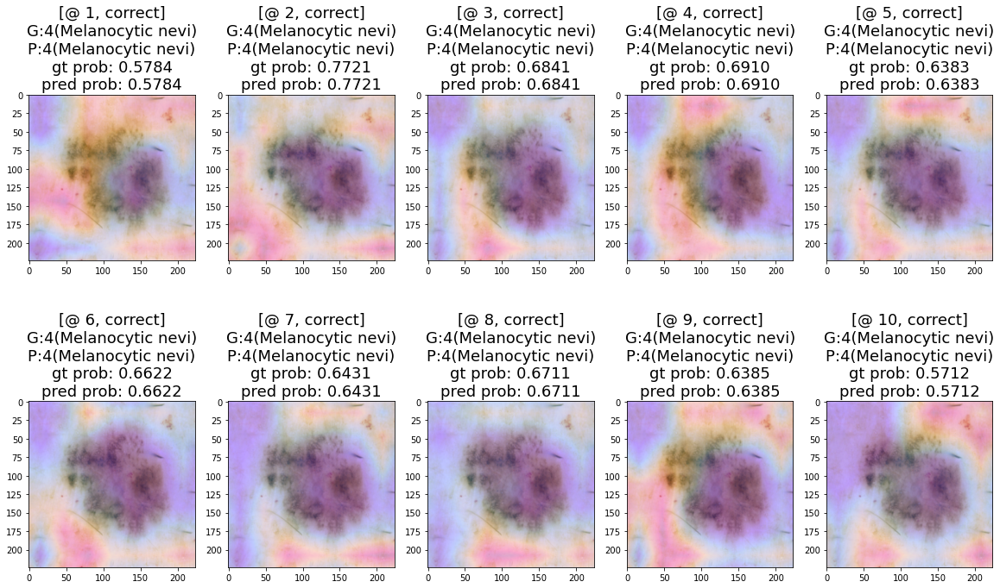

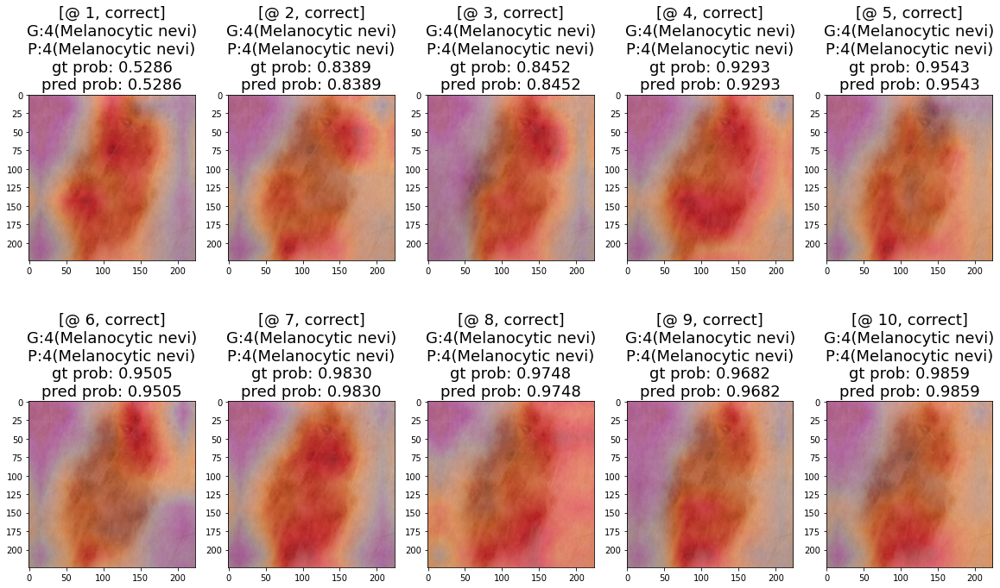

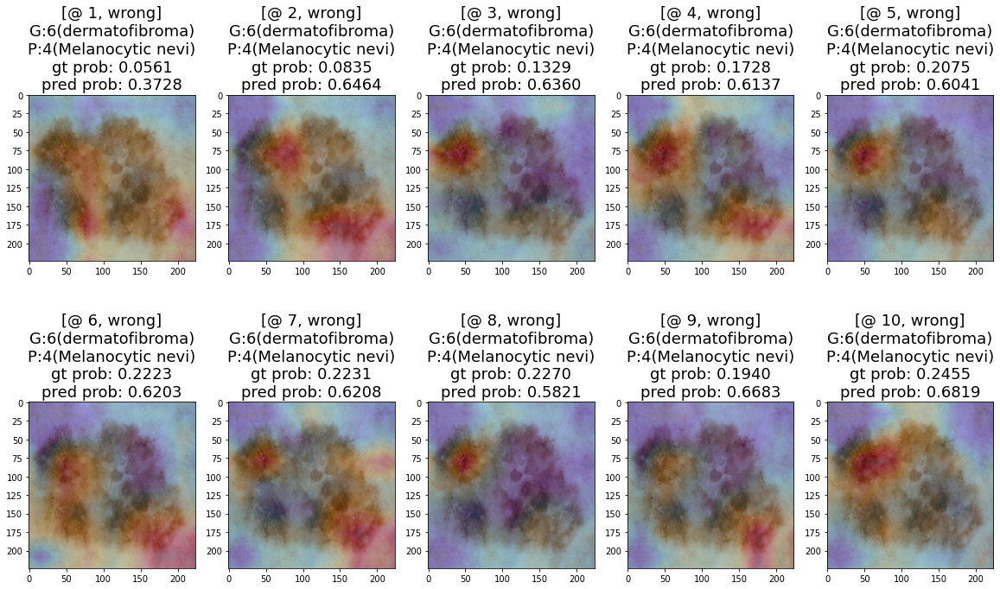

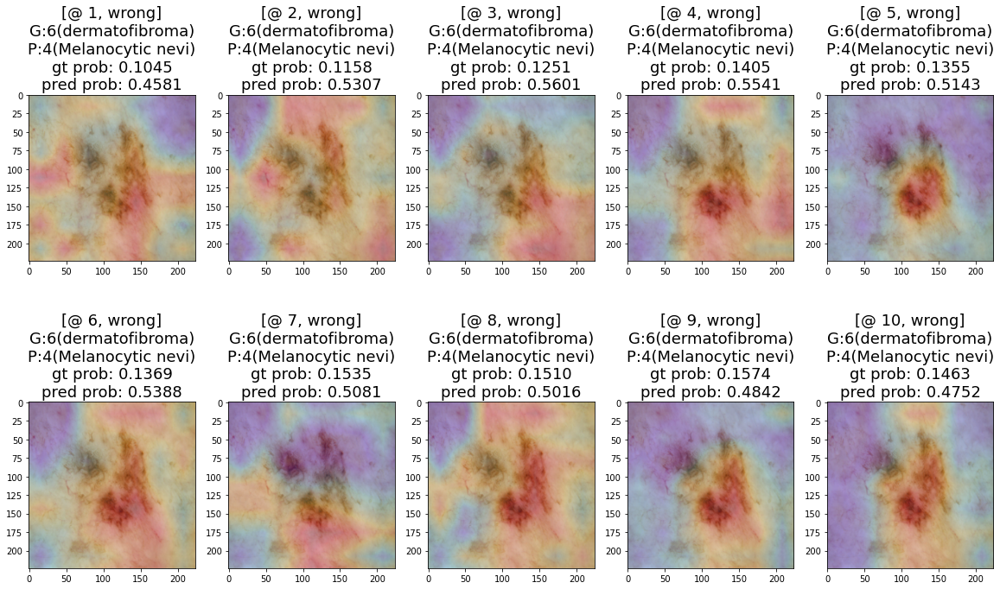

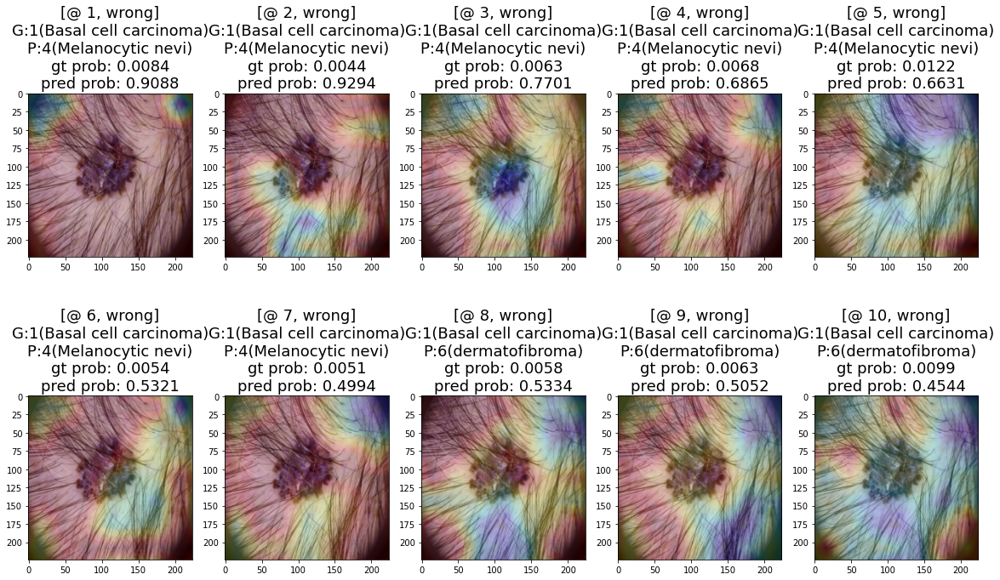

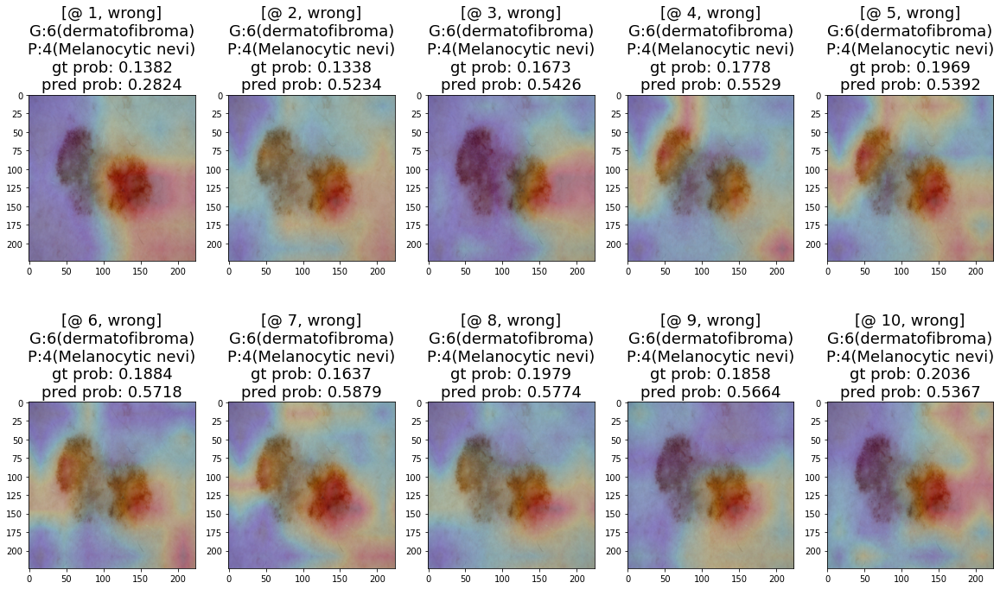

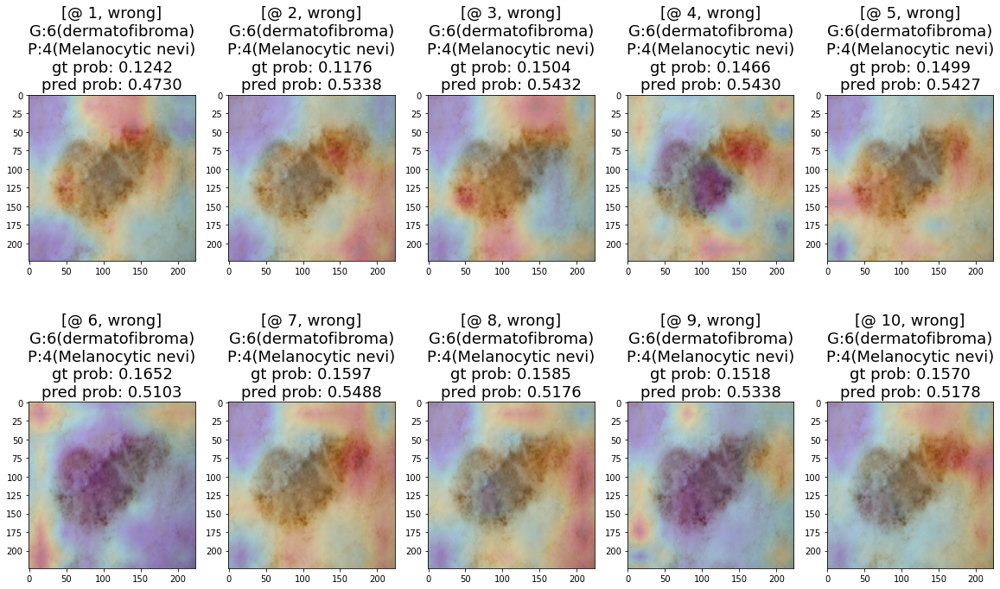

In [ ]:
n_samples = 5
to_list = [k for k in test_img_dict.keys()]

for img_idx in range(len(to_list)):
    epoch_cnt = 1
    name = to_list[img_idx]
    # 각 epoch 별 값
    vals = test_img_dict[to_list[img_idx]]

    overlay_idx = [
    vals[:5],
    vals[5:10]
    ]
    fig, m_axs = plt.subplots(2, n_samples, figsize = (20,12))
    for row_idx,(row_axes, sample_epoch_list) in enumerate(zip(m_axs, overlay_idx)):
        # :5번째, 5:10 번째 epoch에 대한 값들
        for col_idx,(col_ax, sample_epoch_val) in enumerate(zip(row_axes,sample_epoch_list)):
            col_ax.imshow(sample_epoch_val[0])
            col_ax.imshow(sample_epoch_val[1],cmap=plt.cm.jet,alpha=0.2) #bottle_resized = resize(heatmap_j[batch_idx], (224,224))
            gt_val, pred_val = int(sample_epoch_val[2]), int(sample_epoch_val[3])
            gt_prob = F.softmax(sample_epoch_val[4])[gt_val].item()
            pred_prob = torch.max(F.softmax(sample_epoch_val[4])).item() # sample_epoch_val[4]
            if gt_val == pred_val:
                ans = 'correct'
            else:
                ans = 'wrong'
            col_ax.set_title(f"[@ {epoch_cnt}, {ans}]"+'\n'
             + f"G:{gt_val}({categories[gt_val]})"+'\n'
             +f"P:{pred_val}({categories[pred_val]})" + '\n' 
             +f"gt prob: {gt_prob:.4f}"+'\n'
             +f"pred prob: {pred_prob:.4f}" ,
                             fontsize=18)
            epoch_cnt += 1
#             col_ax.set_title(f"[@ {epoch}, {ans}]"+'\n'+
#             f"GT:{gt_val}({categories[gt_val]})"+'\n'
#              +f"PRED:{pred_val}({categories[pred_val]})" +'\n'
#             +f"{sample_name}", fontsize=18)
    plt.show()